# Notebook d'implémentation en production
## Adrian Rodriguez
## Projet 7 parcours Ingénieur Machine Learning
[Accès projet git](https://github.com/Adrian1903/Developpez-une-preuve-de-concept)

[Plus d'informations](https://openclassrooms.com/fr/paths/148-ingenieur-machine-learning)

---
# 0. Contexte
Un rapport sur les erreurs de classification des races de chiens a été soumis à l’association de protection des animaux. Dans ce rapport, il est recommandé d’implémenter une solution de détection d’objet pour améliorer la qualité des photos. Cette solution doit isoler l’objet à classifier en procédant à un rognage.
Cette nouvelle méthode fera appel au dernier YOLO, version 4.

## Sources bibliographiques :
* [Papier sur YOLOv4](https://arxiv.org/pdf/2004.10934v1.pdf)
* [Article sur Medium](https://medium.com/@alexeyab84/yolov4-the-most-accurate-real-time-neural-network-on-ms-coco-dataset-73adfd3602fe)
* [Code source](https://github.com/AlexeyAB/darknet)
* [Tutoriel](https://colab.research.google.com/drive/12QusaaRj_lUwCGDvQNfICpa7kA7_a2dE)

## Prototype
* Dataset : [Stanford Dogs Dataset](https://www.kaggle.com/jessicali9530/stanford-dogs-dataset)
* Méthode baseline : [Modèle Xception 2017 (en production)](https://github.com/Adrian1903/Classez-des-images-l-aide-d-algorithmes-de-Deep-Learning/blob/master/dev/04_cnn_transfer_learning.ipynb) 
* Méthode mise en oeuvre :
  * Phase 1 : Intégration et mesure du détecteur d’objet en production
  * Phase 2 : Si résultat de la phase 1 insuffisant, apprentissage du modèle existant avec photos recadrées et mesure des résultats




Ce notebook présente la phase 1.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
plt.style.use("default")
import seaborn as sns

from keras.models import load_model
from keras.preprocessing.image import load_img, img_to_array

from sklearn.metrics import classification_report

In [3]:
def get_breed(file):
    image = load_img(file, target_size=(299, 299))
    input_array = np.reshape(img_to_array(image), (-1, 299, 299, 3)) / 255

    # Prédiction de la race
    output = model.predict(input_array)
    return class_label.at[output.argmax(axis=-1)[0], 'index']

def get_top3_breeds(model, file):
    image = load_img(file, target_size=(299, 299))
    input_array = np.reshape(img_to_array(image), (-1, 299, 299, 3)) / 255

    # Prédiction de la race
    output = model.predict(input_array)

    df_out = pd.DataFrame(output[0])
    top3_breeds = pd.merge(class_label, df_out, left_index=True, right_index=True).rename(columns={0: 'Probabilité', 'index': 'Race prédite'}).sort_values('Probabilité', ascending=False).head(3)
    return top3_breeds


def get_true_breed(file):
    return file.split('/')[-2].split('-')[1]


def get_best_object(df):
  result_df = pd.DataFrame()
  for i in range(len(df.objects)):

    res = pd.DataFrame(df.objects[i], columns=['class_id', 'name', 'relative_coordinates', 'confidence'])
    if res.empty:
      # NaN si aucun objet détecté (la photo ne sera pas recadrée)
      res.loc[0] = np.nan
    else:
      # Sélection du chien avec la meilleure confidence
      res = res[res.name == "dog"].sort_values(by="confidence", ascending=False).head(1).reset_index(drop=True)

      # NaN si aucun chien détecté (la photo ne sera pas recadrée)
      if res.empty:
        res.loc[0] = np.nan
      else:
        # Extraction des coordonnées de recadrage
        coord = pd.DataFrame.from_dict(res.relative_coordinates.loc[0], orient='index').transpose()
        res = pd.merge(res, coord, left_index=True, right_index=True)

    # Ajout dans un df
    result_df = result_df.append(res)

  return result_df.reset_index(drop=True)

---
# 1. Chargement du modèle et des fichiers nécessaires

In [4]:
path = '/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P7_Développez_une_preuve_de_concept/dev/src/'
model = load_model(path + 'best_model_Xception_DataAugmentation_120_breeds.hdf5')
class_label = pd.read_csv(path + 'class_labels.csv')
test_file = pd.read_csv(path + 'dog_test_split.csv')

---
# 2. Méthode baseline sur méthode en production
Reprise à partir du rapport d'erreur de classification
## 2-1. Extraction des prédictions en erreur

In [5]:
print(f'Nous avons {test_file.shape[0]} images de test')

Nous avons 4116 images de test


In [6]:
path_img = '/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P6_Classez_des_images_à_l_aide_d_algorithmes_de_deep_learning/dev/'

In [7]:
test_file.uri = test_file.uri.apply(lambda x : path_img + x).str.replace('\\', '/')

In [8]:
%time test_file["predicted_breeds"] = test_file.uri.apply(lambda x: get_breed(x))
test_file

CPU times: user 3min 23s, sys: 25.9 s, total: 3min 49s
Wall time: 22min 28s


,uri,breeds,predicted_breeds
0,/content/drive/My Drive/Formation/Informatique...,Boston_bull,Boston_bull
1,/content/drive/My Drive/Formation/Informatique...,toy_poodle,miniature_poodle
2,/content/drive/My Drive/Formation/Informatique...,Staffordshire_bullterrier,Staffordshire_bullterrier
3,/content/drive/My Drive/Formation/Informatique...,dingo,dingo
4,/content/drive/My Drive/Formation/Informatique...,West_Highland_white_terrier,West_Highland_white_terrier
...,...,...,...
4111,/content/drive/My Drive/Formation/Informatique...,Staffordshire_bullterrier,Staffordshire_bullterrier
4112,/content/drive/My Drive/Formation/Informatique...,Old_English_sheepdog,Old_English_sheepdog
4113,/content/drive/My Drive/Formation/Informatique...,Irish_terrier,Irish_terrier
4114,/content/drive/My Drive/Formation/Informatique...,Bedlington_terrier,Bedlington_terrier


In [9]:
error_predict = test_file[test_file.breeds != test_file.predicted_breeds]
error_predict.reset_index(drop=True, inplace=True)
error_predict

,uri,breeds,predicted_breeds
0,/content/drive/My Drive/Formation/Informatique...,toy_poodle,miniature_poodle
1,/content/drive/My Drive/Formation/Informatique...,standard_schnauzer,miniature_schnauzer
2,/content/drive/My Drive/Formation/Informatique...,Sealyham_terrier,soft-coated_wheaten_terrier
3,/content/drive/My Drive/Formation/Informatique...,Japanese_spaniel,Pekinese
4,/content/drive/My Drive/Formation/Informatique...,Yorkshire_terrier,silky_terrier
...,...,...,...
512,/content/drive/My Drive/Formation/Informatique...,cairn,Border_terrier
513,/content/drive/My Drive/Formation/Informatique...,Lhasa,Shih-Tzu
514,/content/drive/My Drive/Formation/Informatique...,English_springer,German_short-haired_pointer
515,/content/drive/My Drive/Formation/Informatique...,Australian_terrier,silky_terrier


---
## 2-3. Etude des prédictions en erreur
### 2-3-1. Visualisation d'un échantillon d'erreur

Cas n°1


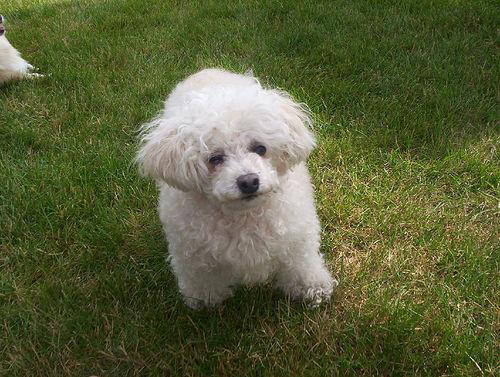

'Race indiquée par les données : toy_poodle'

,Race prédite,Probabilité
104,miniature_poodle,0.652671
115,toy_poodle,0.347219
41,Lakeland_terrier,0.000037


#############################################################

Cas n°2


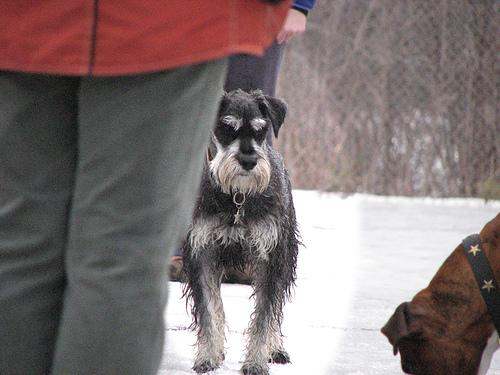

'Race indiquée par les données : standard_schnauzer'

,Race prédite,Probabilité
105,miniature_schnauzer,8.540156e-01
114,standard_schnauzer,1.459842e-01
94,giant_schnauzer,1.734078e-07


#############################################################

Cas n°3


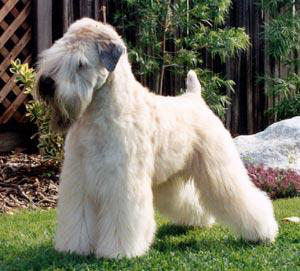

'Race indiquée par les données : Sealyham_terrier'

,Race prédite,Probabilité
112,soft-coated_wheaten_terrier,0.956069
61,Sealyham_terrier,0.037118
41,Lakeland_terrier,0.003409


#############################################################

Cas n°4


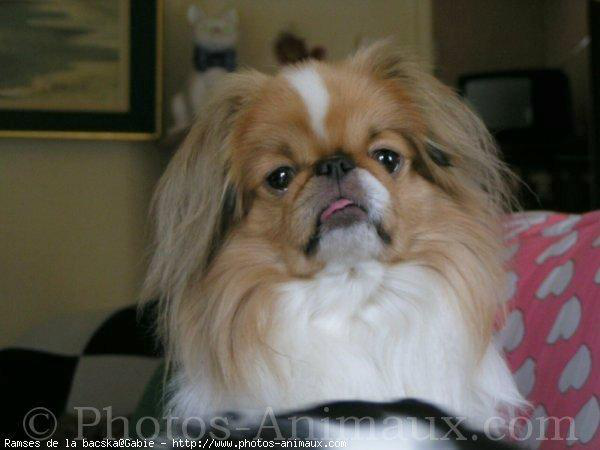

'Race indiquée par les données : Japanese_spaniel'

,Race prédite,Probabilité
51,Pekinese,0.682957
38,Japanese_spaniel,0.316960
63,Shih-Tzu,0.000057


#############################################################

Cas n°5


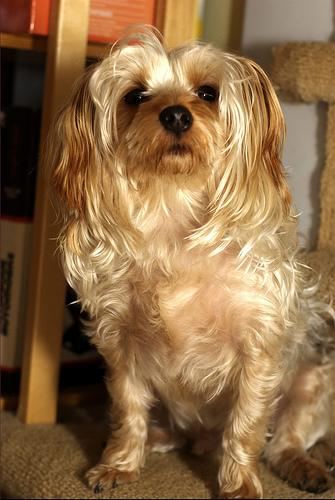

'Race indiquée par les données : Yorkshire_terrier'

,Race prédite,Probabilité
111,silky_terrier,0.556030
73,Yorkshire_terrier,0.438188
5,Australian_terrier,0.005672


#############################################################

Cas n°6


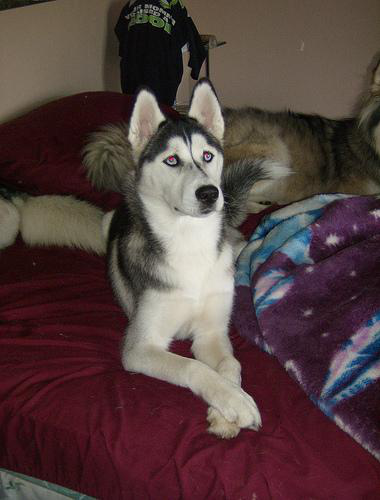

'Race indiquée par les données : Eskimo_dog'

,Race prédite,Probabilité
64,Siberian_husky,0.703306
24,Eskimo_dog,0.241922
101,malamute,0.054724


#############################################################

Cas n°7


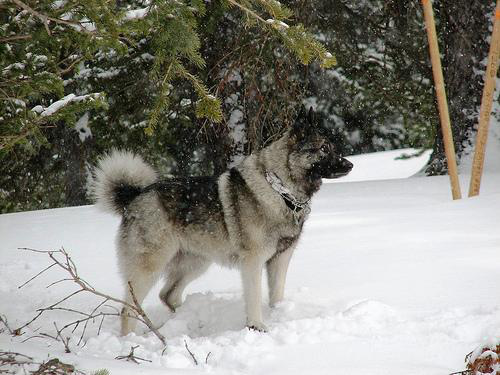

'Race indiquée par les données : Norwegian_elkhound'

,Race prédite,Probabilité
101,malamute,0.633134
48,Norwegian_elkhound,0.357203
24,Eskimo_dog,0.006938


#############################################################

Cas n°8


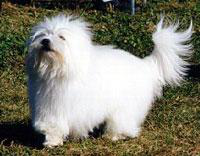

'Race indiquée par les données : Dandie_Dinmont'

,Race prédite,Probabilité
68,Tibetan_terrier,0.726644
44,Maltese_dog,0.108286
43,Lhasa,0.054459


#############################################################

Cas n°9


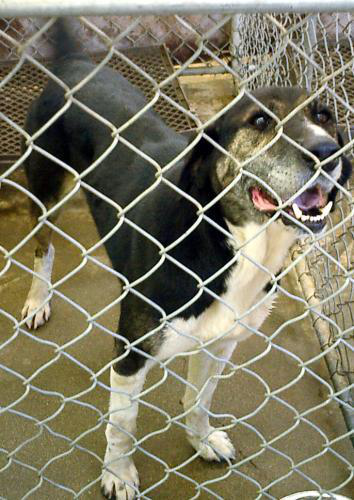

'Race indiquée par les données : Walker_hound'

,Race prédite,Probabilité
40,Labrador_retriever,0.055117
29,Great_Dane,0.046484
93,flat-coated_retriever,0.044625


#############################################################

Cas n°10


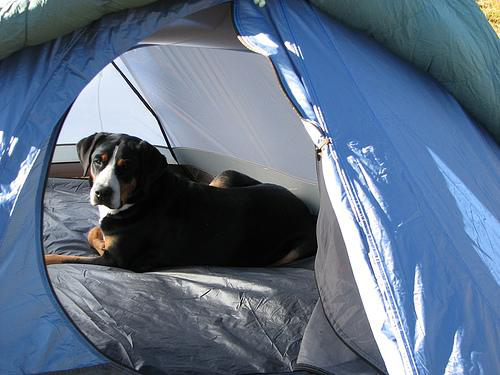

'Race indiquée par les données : Greater_Swiss_Mountain_dog'

,Race prédite,Probabilité
23,EntleBucher,0.616895
31,Greater_Swiss_Mountain_dog,0.232895
4,Appenzeller,0.139398


#############################################################

Cas n°11


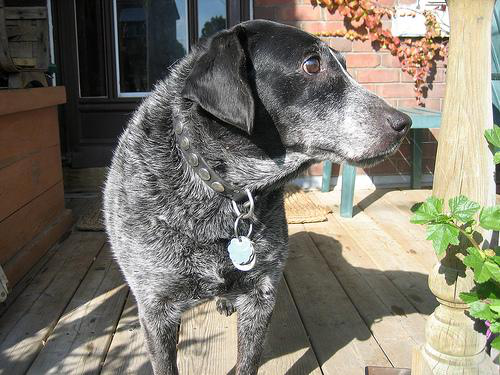

'Race indiquée par les données : bluetick'

,Race prédite,Probabilité
27,German_short-haired_pointer,0.770263
80,bluetick,0.229263
40,Labrador_retriever,0.000402


#############################################################

Cas n°12


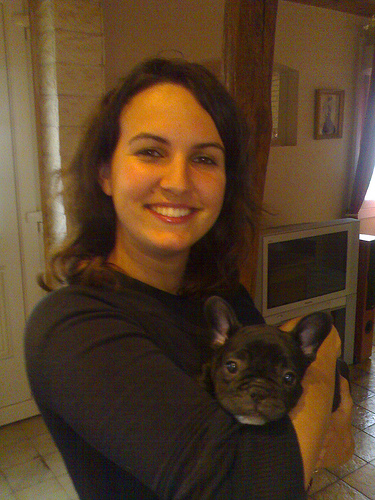

'Race indiquée par les données : French_bulldog'

,Race prédite,Probabilité
17,Chihuahua,0.897360
25,French_bulldog,0.070206
103,miniature_pinscher,0.013219


#############################################################

Cas n°13


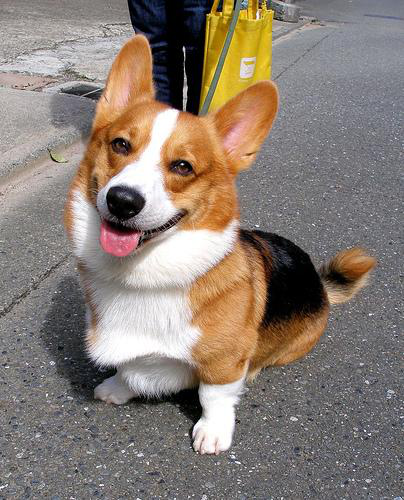

'Race indiquée par les données : Cardigan'

,Race prédite,Probabilité
52,Pembroke,0.655918
15,Cardigan,0.344061
107,papillon,0.000019


#############################################################

Cas n°14


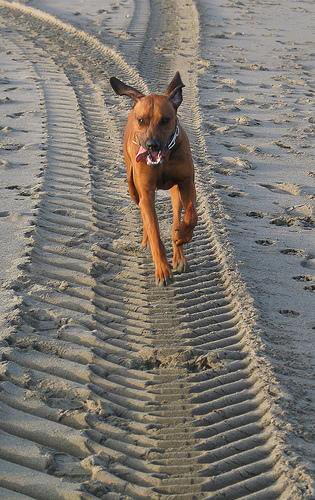

'Race indiquée par les données : Rhodesian_ridgeback'

,Race prédite,Probabilité
103,miniature_pinscher,0.354982
116,toy_terrier,0.185895
13,Brabancon_griffon,0.129670


#############################################################

Cas n°15


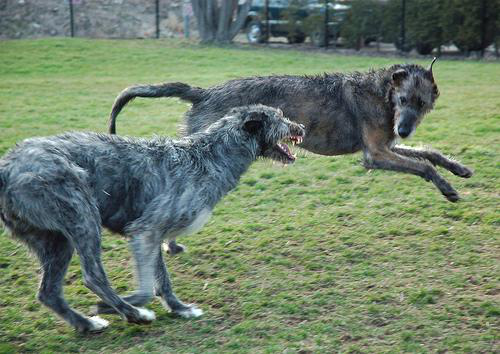

'Race indiquée par les données : Irish_wolfhound'

,Race prédite,Probabilité
60,Scottish_deerhound,9.515973e-01
36,Irish_wolfhound,4.840273e-02
118,whippet,6.883465e-10


#############################################################

Cas n°16


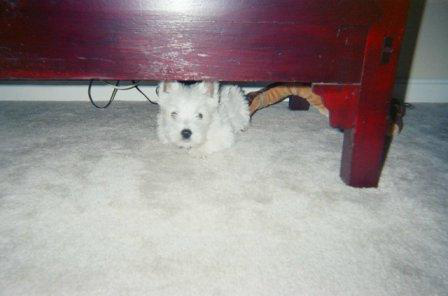

'Race indiquée par les données : West_Highland_white_terrier'

,Race prédite,Probabilité
58,Samoyed,0.662487
72,West_Highland_white_terrier,0.152814
41,Lakeland_terrier,0.054210


#############################################################

Cas n°17


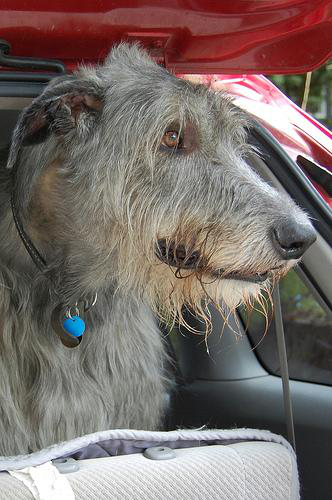

'Race indiquée par les données : Irish_wolfhound'

,Race prédite,Probabilité
60,Scottish_deerhound,0.999046
36,Irish_wolfhound,0.000948
81,borzoi,0.000005


#############################################################

Cas n°18


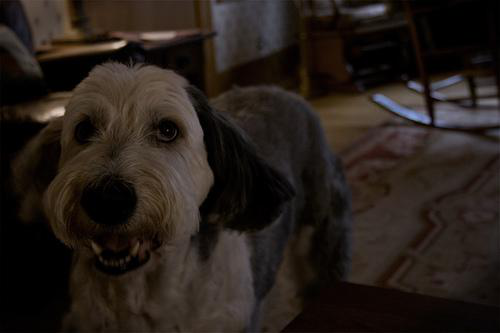

'Race indiquée par les données : Old_English_sheepdog'

,Race prédite,Probabilité
106,otterhound,0.450279
68,Tibetan_terrier,0.264938
50,Old_English_sheepdog,0.079104


#############################################################

Cas n°19


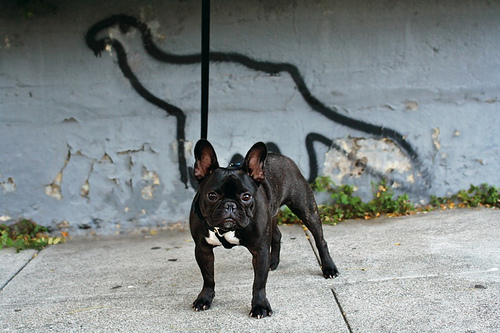

'Race indiquée par les données : French_bulldog'

,Race prédite,Probabilité
13,Brabancon_griffon,0.614220
103,miniature_pinscher,0.207548
19,Doberman,0.033202


#############################################################

Cas n°20


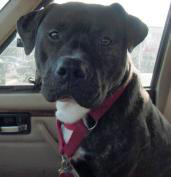

'Race indiquée par les données : American_Staffordshire_terrier'

,Race prédite,Probabilité
65,Staffordshire_bullterrier,0.576555
3,American_Staffordshire_terrier,0.423019
40,Labrador_retriever,0.000220


#############################################################



In [10]:
i = 1
for img in error_predict.uri.head(20):
    print(f"Cas n°{i}")
    display(load_img(img))
    display("Race indiquée par les données : " + get_true_breed(img))
    display(get_top3_breeds(model, img))
    print("#############################################################")
    print("")
    i += 1

### 2-3-2. Retour sur le cas n°3 
(Cas traité par l'association en fournissant leur propre jeu de donnée)

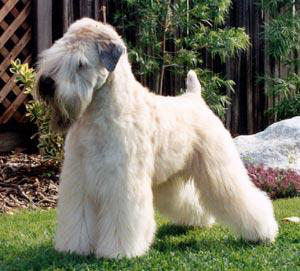

'Race indiquée par les données : Sealyham_terrier'

,Race prédite,Probabilité
112,soft-coated_wheaten_terrier,0.956069
61,Sealyham_terrier,0.037118
41,Lakeland_terrier,0.003409


In [11]:
img = error_predict.uri[2]
display(load_img(img))
display("Race indiquée par les données : " + get_true_breed(img))
display(get_top3_breeds(model, img))

In [12]:
test_file.uri[0]

'/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P6_Classez_des_images_à_l_aide_d_algorithmes_de_deep_learning/dev/src/img/n02096585-Boston_bull/n02096585_1571.jpg'

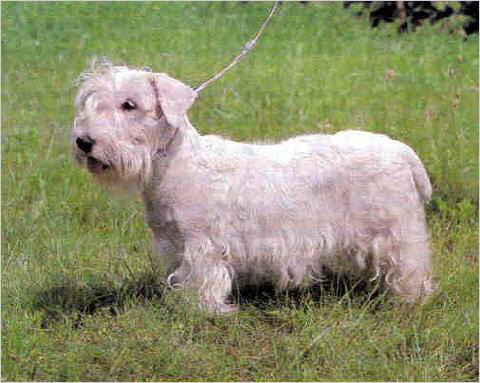

In [13]:
file = path_img + 'src/img/n02095889-Sealyham_terrier/n02095889_61.jpg'
display(load_img(file))

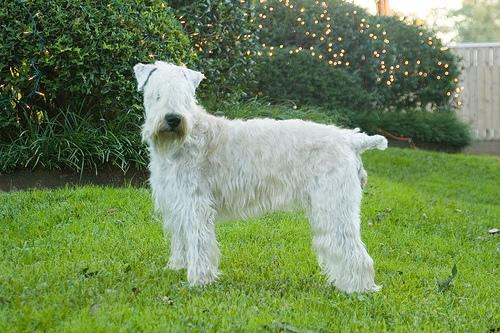

In [14]:
file = path_img + 'src/img/n02098105-soft-coated_wheaten_terrier/n02098105_3591.jpg'
display(load_img(file))

Dans ce cas, il s'agit d'une erreur humaine. La photo est dans le mauvais dossier (mauvaise race attribué). Cependant, l'ordinateur a identifié la bonne race.

### 2-3-3. Retour sur le cas n°12
(Cas traité à l'aide du détecteur d'objet)

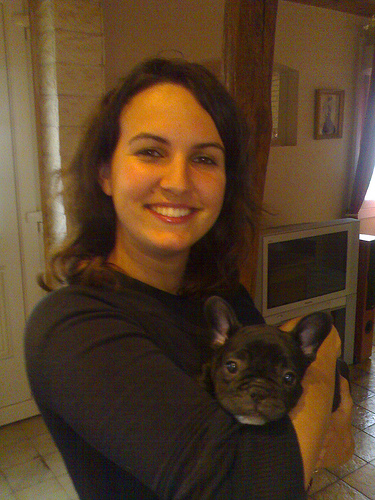

'Race indiquée par les données : French_bulldog'

,Race prédite,Probabilité
17,Chihuahua,0.897360
25,French_bulldog,0.070206
103,miniature_pinscher,0.013219


In [15]:
img = error_predict.uri[11]
display(load_img(img))
display("Race indiquée par les données : " + get_true_breed(img))
display(get_top3_breeds(model, img))

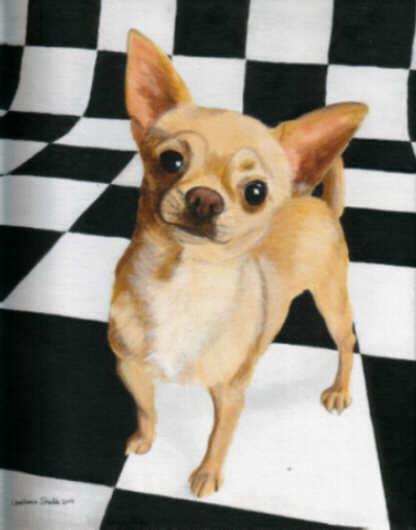

In [16]:
file = path_img + 'src/img/n02085620-Chihuahua/n02085620_952.jpg'
display(load_img(file))

En effet, il y a une erreur de prédiction. La race présentée n'est pas un Chihuahua. Renouvelons l'expérience avec la même photo, mais recadrée sur ce que l'on souhaite identifier.

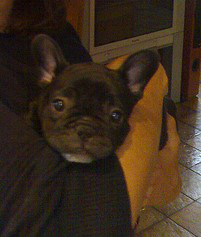

,Race prédite,Probabilité
25,French_bulldog,9.999774e-01
17,Chihuahua,2.222603e-05
15,Cardigan,4.017094e-07


In [17]:
img = path_img + 'src/img/img test api/_n02108915_623_recadrée.jpg'
display(load_img(img))
display(get_top3_breeds(model, img))

Une fois la photo recadrée, la machine ne se trompe plus. Pour résoudre ce problème, nous pouvons former l'humain à mieux qualifier les photos à donner à la machine.

## 2-4. Conclusion sur la méthode actuellement en production
En corrigeant les erreurs vues dans les étapes précédentes, nous pouvons encore améliorer considérablement les performances de l'algorithme. Je recommande d'être soigneux dans le choix et l'identification des photos à donner en apprentissage pour la machine, mais aussi en production.

In [18]:
accuracy_best_model = round((test_file.shape[0] - error_predict.shape[0]) / test_file.shape[0]*100, 1)
print(f'Précision du modèle : {accuracy_best_model} %')

Précision du modèle : 87.4 %


In [19]:
class_report = classification_report(test_file.breeds, test_file.predicted_breeds, output_dict=True)
class_report_df = pd.DataFrame.from_dict(class_report, orient='columns').transpose().head(-3)
pd.set_option('display.max_rows', None)
class_report_df.sort_values('precision')

,precision,recall,f1-score,support
Tibetan_mastiff,0.509091,0.933333,0.658824,30.0
Eskimo_dog,0.538462,0.269231,0.358974,26.0
English_foxhound,0.568966,0.970588,0.717391,34.0
miniature_poodle,0.607143,0.680000,0.641509,25.0
Siberian_husky,0.623188,0.877551,0.728814,49.0
Chesapeake_Bay_retriever,0.659574,0.837838,0.738095,37.0
collie,0.666667,0.666667,0.666667,27.0
Shih-Tzu,0.675676,0.862069,0.757576,29.0
Tibetan_terrier,0.677419,0.933333,0.785047,45.0
American_Staffordshire_terrier,0.703704,0.612903,0.655172,31.0


---
# 3. Méthode améliorée d'un détecteur d'objet (YOLOv4)

## 3-1. Construction de détecteur et chargement des poids de YOLOv4

In [20]:
%%capture
# clone darknet repo
!git clone https://github.com/AlexeyAB/darknet

# change makefile to have GPU and OPENCV enabled
%cd darknet
!sed -i 's/OPENCV=0/OPENCV=1/' Makefile
!sed -i 's/GPU=0/GPU=1/' Makefile
!sed -i 's/CUDNN=0/CUDNN=1/' Makefile
!sed -i 's/CUDNN_HALF=0/CUDNN_HALF=1/' Makefile

# verify CUDA
!/usr/local/cuda/bin/nvcc --version

# make darknet (builds darknet so that you can then use the darknet executable file to run or train object detectors)
!make

In [21]:
%%capture
!wget https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v3_optimal/yolov4.weights

## 3-2 Identification d'un objet

In [22]:
error_predict.uri[1]

'/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P6_Classez_des_images_à_l_aide_d_algorithmes_de_deep_learning/dev/src/img/n02097209-standard_schnauzer/n02097209_2382.jpg'

In [23]:
%%capture
!./darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights -ext_output "/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P6_Classez_des_images_à_l_aide_d_algorithmes_de_deep_learning/dev/src/img/n02097209-standard_schnauzer/n02097209_2382.jpg"

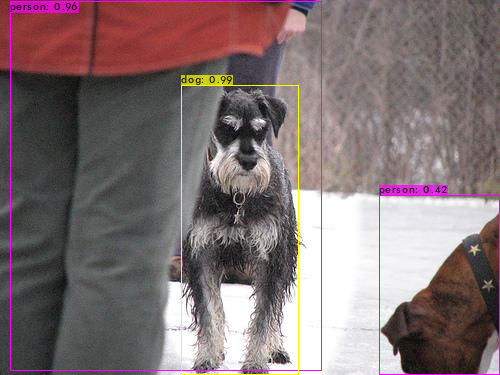

In [24]:
load_img('predictions.jpg')

Le chien a bien été détecté. L'enjeu est maintenant d'isoler l'objet à classifier

## 3.3. Expérimentation sur le fichier des images prédites en erreur

### 3-3-1. Identification des chiens

In [25]:
%%capture
# Extraction des uri dans un fichier texte
error_predict.uri.to_csv('/content/images_error.txt', index=False, header=False)
# Détection des objets identifiés dans les images à partir du fichier texte
# Stockage des résultats dans un JSON
!./darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights -dont_show -ext_output -out /content/result.json < /content/images_error.txt

In [26]:
# Transformation du JSON en dataframe
result_crop = pd.read_json('/content/result.json')
# Récupération de l'objet identifié comme un chien avec la meilleur confidence
result_crop = get_best_object(result_crop)
# Assemblage des données dans un dataframe
error_predict_crop = pd.merge(error_predict, result_crop, left_index=True, right_index=True)
col = ['uri', 'breeds',	'predicted_breeds', 'center_x', 'center_y', 'width', 'height']
error_predict_crop = error_predict_crop[col]
error_predict_crop.head()

,uri,breeds,predicted_breeds,center_x,center_y,width,height
0,/content/drive/My Drive/Formation/Informatique...,toy_poodle,miniature_poodle,0.467455,0.507713,0.395568,0.650054
1,/content/drive/My Drive/Formation/Informatique...,standard_schnauzer,miniature_schnauzer,0.479141,0.612768,0.234255,0.769521
2,/content/drive/My Drive/Formation/Informatique...,Sealyham_terrier,soft-coated_wheaten_terrier,0.511100,0.512058,0.874051,0.911958
3,/content/drive/My Drive/Formation/Informatique...,Japanese_spaniel,Pekinese,0.559252,0.533149,0.713220,0.917417
4,/content/drive/My Drive/Formation/Informatique...,Yorkshire_terrier,silky_terrier,0.548168,0.513692,0.884070,0.869686


### 3-3-2. Visualisation des résultats sur le même échantillon du rapport de classification

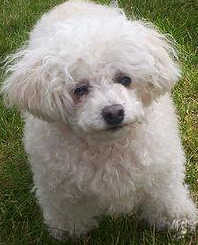

,Race prédite,Probabilité
104,miniature_poodle,0.949365
115,toy_poodle,0.050607
41,Lakeland_terrier,0.000025


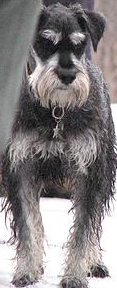

,Race prédite,Probabilité
114,standard_schnauzer,0.787192
105,miniature_schnauzer,0.212792
94,giant_schnauzer,0.000015


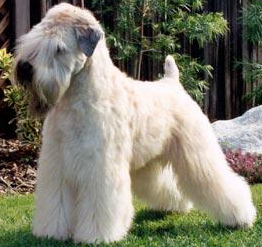

,Race prédite,Probabilité
112,soft-coated_wheaten_terrier,0.600788
61,Sealyham_terrier,0.371660
39,Kerry_blue_terrier,0.017642


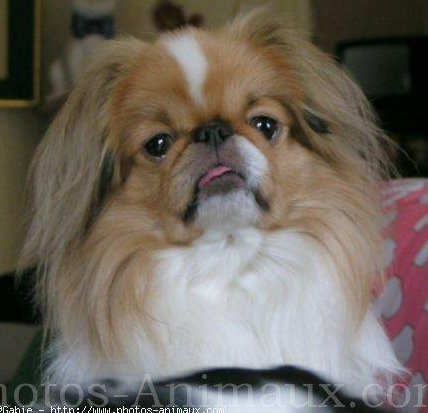

,Race prédite,Probabilité
38,Japanese_spaniel,0.831609
51,Pekinese,0.168314
63,Shih-Tzu,0.000053


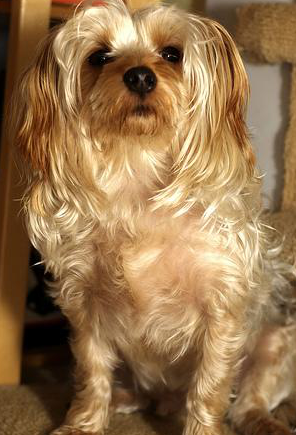

,Race prédite,Probabilité
111,silky_terrier,0.569506
73,Yorkshire_terrier,0.427583
5,Australian_terrier,0.002841


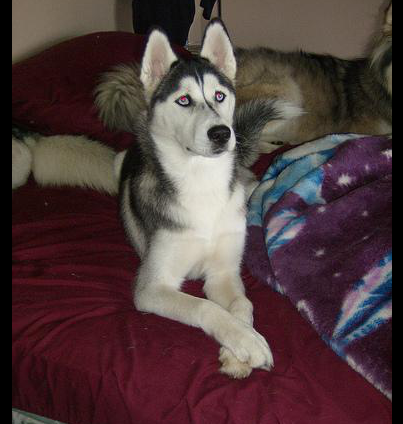

,Race prédite,Probabilité
64,Siberian_husky,0.801461
24,Eskimo_dog,0.181698
101,malamute,0.016807


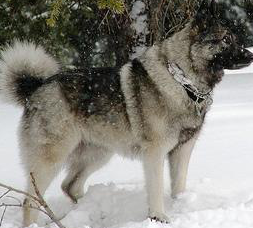

,Race prédite,Probabilité
48,Norwegian_elkhound,0.998361
101,malamute,0.001198
97,keeshond,0.000360


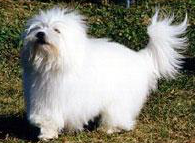

,Race prédite,Probabilité
68,Tibetan_terrier,0.823656
44,Maltese_dog,0.061282
38,Japanese_spaniel,0.042293


Non identifié comme un chien


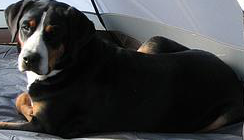

,Race prédite,Probabilité
31,Greater_Swiss_Mountain_dog,0.985689
4,Appenzeller,0.010193
23,EntleBucher,0.003996


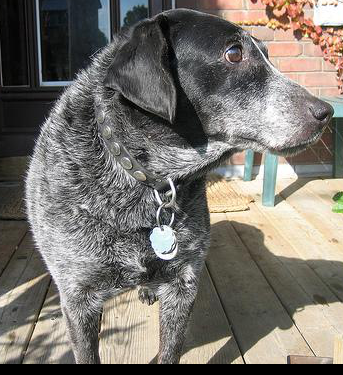

,Race prédite,Probabilité
80,bluetick,0.977133
27,German_short-haired_pointer,0.022844
40,Labrador_retriever,0.000016


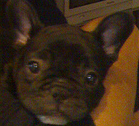

,Race prédite,Probabilité
25,French_bulldog,0.993133
17,Chihuahua,0.006508
116,toy_terrier,0.000185


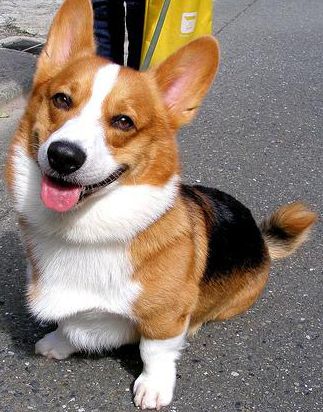

,Race prédite,Probabilité
15,Cardigan,0.708011
52,Pembroke,0.291971
107,papillon,0.000014


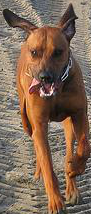

,Race prédite,Probabilité
54,Rhodesian_ridgeback,0.605623
103,miniature_pinscher,0.335818
116,toy_terrier,0.029752


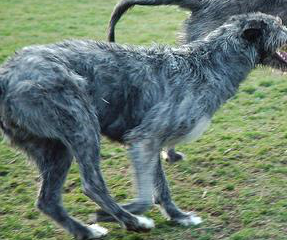

,Race prédite,Probabilité
60,Scottish_deerhound,9.974892e-01
36,Irish_wolfhound,2.510746e-03
81,borzoi,1.899020e-08


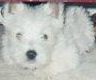

,Race prédite,Probabilité
72,West_Highland_white_terrier,0.921482
61,Sealyham_terrier,0.065799
41,Lakeland_terrier,0.006935


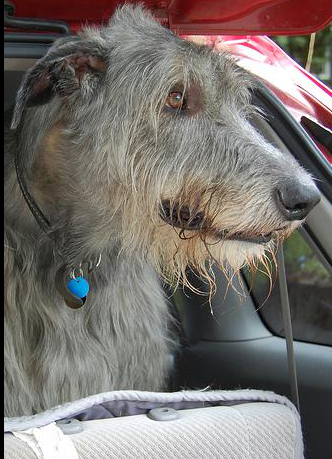

,Race prédite,Probabilité
60,Scottish_deerhound,0.999222
36,Irish_wolfhound,0.000768
81,borzoi,0.000010


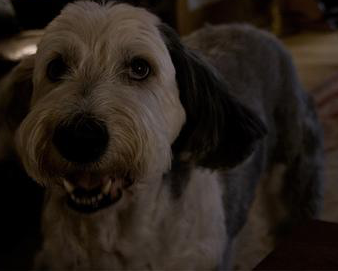

,Race prédite,Probabilité
106,otterhound,0.564522
36,Irish_wolfhound,0.077975
68,Tibetan_terrier,0.056784


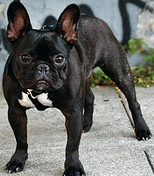

,Race prédite,Probabilité
25,French_bulldog,0.999995
11,Boston_bull,0.000002
108,pug,0.000002


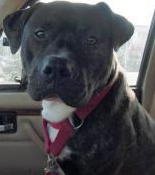

,Race prédite,Probabilité
65,Staffordshire_bullterrier,0.718867
3,American_Staffordshire_terrier,0.281021
40,Labrador_retriever,0.000040


In [27]:
for i in range(20):
  img = error_predict_crop.uri[i]
  img = load_img(img)
  # display(img)
  width, height = img.size
  # display(width, height)
  if ~np.isnan(error_predict_crop.center_x[i]):
    # Transformation des coordonnées relatives en coordonnées interprétables
    center_x = width * error_predict_crop['center_x'][i]
    center_y = height * error_predict_crop['center_y'][i]
    h_crop = height * error_predict_crop['height'][i]
    w_crop = width * error_predict_crop['width'][i]

    left = center_x - w_crop / 2
    top = center_y - h_crop / 2
    right = center_x + w_crop / 2
    bottom = center_y + h_crop / 2

    # display(left, top, right, bottom)

    # Rognage sur objet à identifier et transformation avant prédicition
    img_cropped = img.crop((left, top, right, bottom))
    display(img_cropped)

    img_cropped = img_cropped.resize((299, 299))
    input_array = np.reshape(img_to_array(img_cropped), (-1, 299, 299, 3)) / 255

    # Prédiction de la race
    output = model.predict(input_array)

    df_out = pd.DataFrame(output[0])
    top3_breeds = pd.merge(class_label, df_out, left_index=True, right_index=True).rename(columns={0: 'Probabilité', 'index': 'Race prédite'}).sort_values('Probabilité', ascending=False).head(3)
    display(top3_breeds)
  else: print("Non identifié comme un chien")

Les chiens sont effectivement bien isolés, et les races sont putôt bien prédites. Hormis la gestion des erreurs humaine de classification de races. 

In [28]:
# TO DO  : Evaluer la réduction d'erreur uniquement sur le fichier d'erreur
error_predict_crop['predicted_breeds_crop'] = np.nan
for i in range(len(error_predict_crop)):
  # print(f'Traitement de la photo {i} en cours ...')
  img = error_predict_crop.uri[i]
  img = load_img(img)

  width, height = img.size

  # Rognage si chien détecté
  if ~np.isnan(error_predict_crop.center_x[i]):
    # Transformation des coordonnées relatives en coordonnées interprétables
    center_x = width * error_predict_crop['center_x'][i]
    center_y = height * error_predict_crop['center_y'][i]
    h_crop = height * error_predict_crop['height'][i]
    w_crop = width * error_predict_crop['width'][i]

    left = center_x - w_crop / 2
    top = center_y - h_crop / 2
    right = center_x + w_crop / 2
    bottom = center_y + h_crop / 2

    # Rognage sur objet à identifier et transformation avant prédicition
    img = img.crop((left, top, right, bottom))

  # Classification de la photo avec ou sans rognage
  img = img.resize((299, 299))
  input_array = np.reshape(img_to_array(img), (-1, 299, 299, 3)) / 255

  # Prédiction de la race
  output = model.predict(input_array)
  breeds = class_label.at[output.argmax(axis=-1)[0], 'index']
  error_predict_crop['predicted_breeds_crop'].loc[i] = breeds

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [29]:
n_new_error = error_predict_crop[error_predict_crop.breeds != error_predict_crop.predicted_breeds_crop].shape[0]
error_reduce = round(1 - n_new_error / error_predict_crop.shape[0], 2) * 100
print(f"Les erreurs de prédiction ont été réduites de {error_reduce} % sur le fichier d'erreur.")

Les erreurs de prédiction ont été réduites de 35.0 % sur le fichier d'erreur.


## 3-4. Généralisation sur le fichier de test

L'implémentation du l'algorithmes peut induire des erreurs qui n'aurait pas eu pas lieu. Cherchons à les quantifier.


### 3-4-1. Capture des objets sur l'échantillon de test

In [30]:
%%capture
# Extraction des uri dans un fichier texte
test_file.uri.to_csv('/content/images_test.txt', index=False, header=False)
# Détection des objets identifiés dans les images à partir du fichier texte
# Stockage des résultats dans un JSON
!./darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights -dont_show -ext_output -out "/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P7_Développez_une_preuve_de_concept/dev/src/result_test.json" < /content/images_test.txt

In [31]:
# Transformation du JSON en dataframe
result_crop = pd.read_json("/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P7_Développez_une_preuve_de_concept/dev/src/result_test.json")
# Récupération de l'objet identifié comme un chien avec la meilleur confidence
result_crop = get_best_object(result_crop)
# Assemblage des données dans un dataframe
test_file = pd.merge(test_file, result_crop, left_index=True, right_index=True)
col = ['uri', 'breeds',	'predicted_breeds', 'center_x', 'center_y', 'width', 'height']
test_file = test_file[col]
test_file.head()

,uri,breeds,predicted_breeds,center_x,center_y,width,height
0,/content/drive/My Drive/Formation/Informatique...,Boston_bull,Boston_bull,0.506313,0.497488,0.705340,0.855740
1,/content/drive/My Drive/Formation/Informatique...,toy_poodle,miniature_poodle,0.467455,0.507713,0.395568,0.650054
2,/content/drive/My Drive/Formation/Informatique...,Staffordshire_bullterrier,Staffordshire_bullterrier,0.549928,0.623763,0.929981,0.762959
3,/content/drive/My Drive/Formation/Informatique...,dingo,dingo,0.443700,0.504583,0.822173,0.989210
4,/content/drive/My Drive/Formation/Informatique...,West_Highland_white_terrier,West_Highland_white_terrier,0.548143,0.547041,0.432979,0.712642


In [32]:
test_file['predicted_breeds_crop'] = np.nan
for i in range(len(test_file)):
  # print(f'Traitement de la photo {i} en cours ...')
  img = test_file.uri[i]
  img = load_img(img)

  width, height = img.size

  # Rognage si chien détecté
  if ~np.isnan(test_file.center_x[i]):
    # Transformation des coordonnées relatives en coordonnées interprétables
    center_x = width * test_file['center_x'][i]
    center_y = height * test_file['center_y'][i]
    h_crop = height * test_file['height'][i]
    w_crop = width * test_file['width'][i]

    left = center_x - w_crop / 2
    top = center_y - h_crop / 2
    right = center_x + w_crop / 2
    bottom = center_y + h_crop / 2

    # Rognage sur objet à identifier et transformation avant prédicition
    img = img.crop((left, top, right, bottom))

  # Classification de la photo avec ou sans rognage
  img = img.resize((299, 299))
  input_array = np.reshape(img_to_array(img), (-1, 299, 299, 3)) / 255

  # Prédiction de la race
  output = model.predict(input_array)
  breeds = class_label.at[output.argmax(axis=-1)[0], 'index']
  
  test_file['predicted_breeds_crop'].loc[i] = breeds

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [33]:
test_error_predict_crop = test_file[test_file.breeds != test_file.predicted_breeds_crop]
test_error_predict_crop.reset_index(drop=True, inplace=True)

accuracy_best_model = round((test_file.shape[0] - test_error_predict_crop.shape[0]) / test_file.shape[0]*100, 1)
print(f'Précision du modèle : {accuracy_best_model} %')

Précision du modèle : 87.5 %


La précision de modèle n'a quasiment pas évolué (+ 0.1 %). Je vais comprendre les erreurs induites

### 3-4-2. Compréhension des erreurs induites

Cas n°0


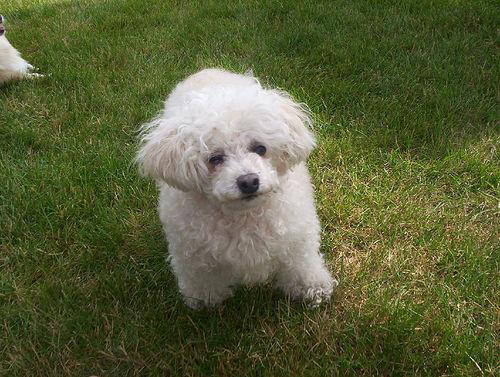

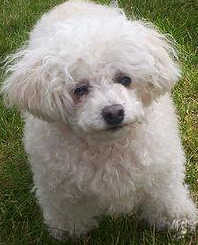

Race donnée : toy_poodle
Race sans rognage : miniature_poodle
Race prédite avec rognage si détection : miniature_poodle
#############################################################

Cas n°1


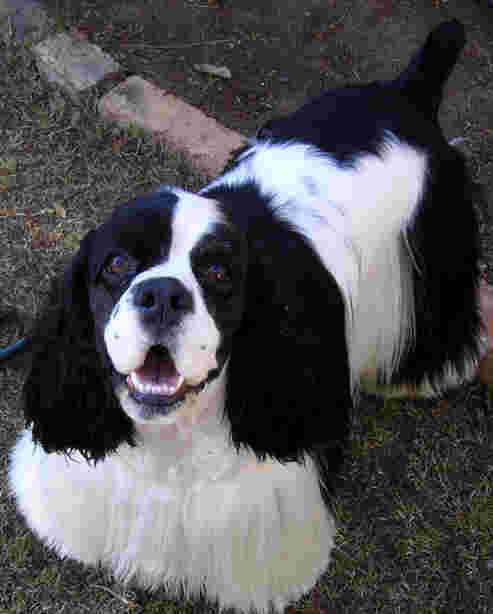

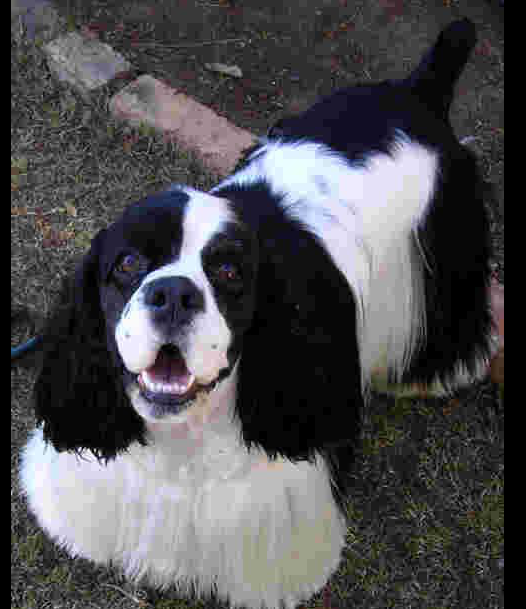

Race donnée : cocker_spaniel
Race sans rognage : cocker_spaniel
Race prédite avec rognage si détection : Blenheim_spaniel
#############################################################

Cas n°2


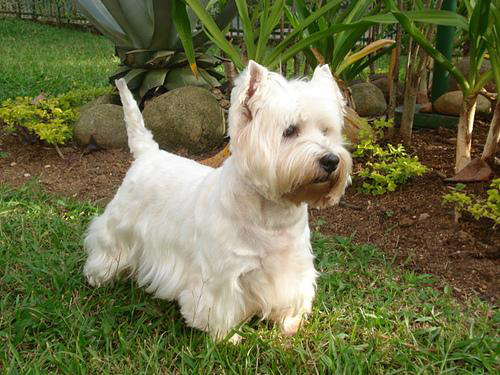

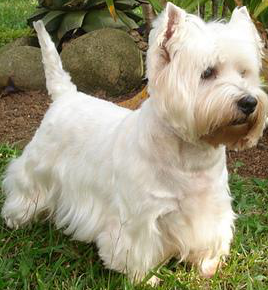

Race donnée : West_Highland_white_terrier
Race sans rognage : West_Highland_white_terrier
Race prédite avec rognage si détection : Sealyham_terrier
#############################################################

Cas n°3


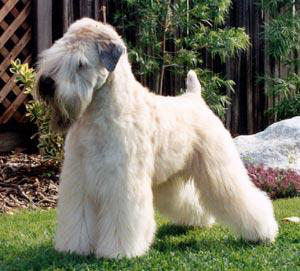

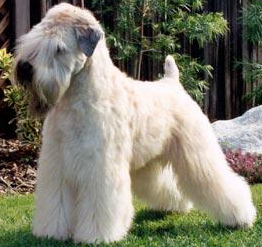

Race donnée : Sealyham_terrier
Race sans rognage : soft-coated_wheaten_terrier
Race prédite avec rognage si détection : soft-coated_wheaten_terrier
#############################################################

Cas n°4


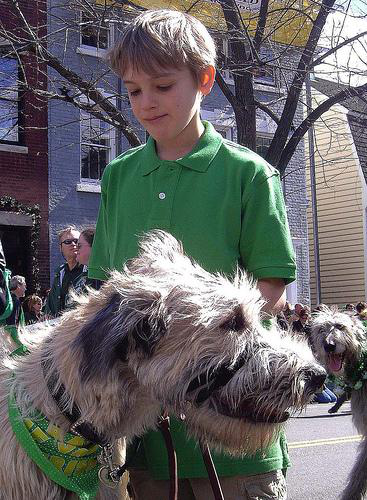

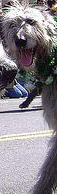

Race donnée : Irish_wolfhound
Race sans rognage : Irish_wolfhound
Race prédite avec rognage si détection : cairn
#############################################################

Cas n°5


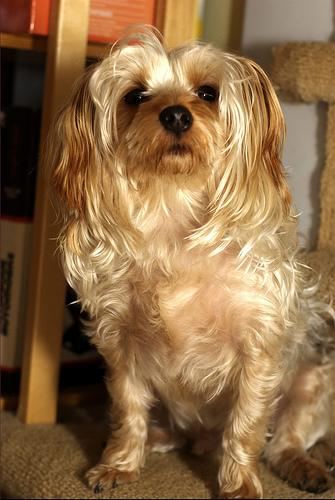

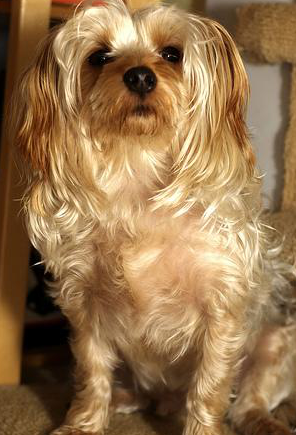

Race donnée : Yorkshire_terrier
Race sans rognage : silky_terrier
Race prédite avec rognage si détection : silky_terrier
#############################################################

Cas n°6


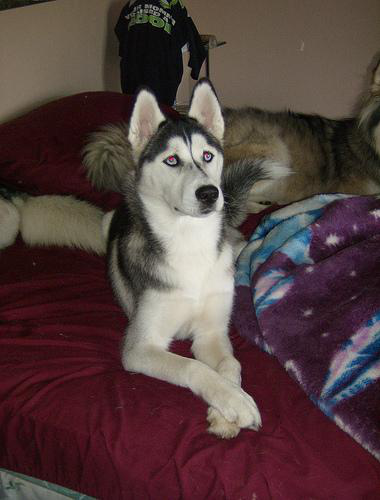

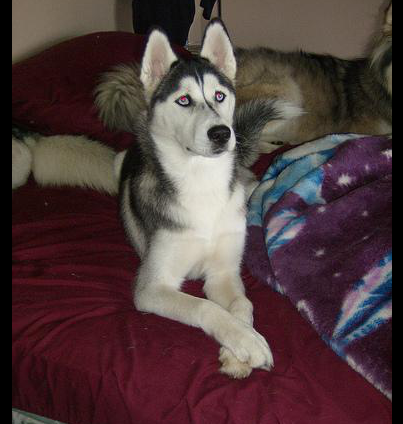

Race donnée : Eskimo_dog
Race sans rognage : Siberian_husky
Race prédite avec rognage si détection : Siberian_husky
#############################################################

Cas n°7


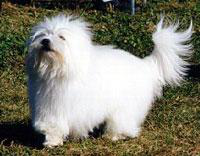

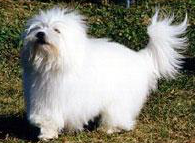

Race donnée : Dandie_Dinmont
Race sans rognage : Tibetan_terrier
Race prédite avec rognage si détection : Tibetan_terrier
#############################################################

Cas n°8


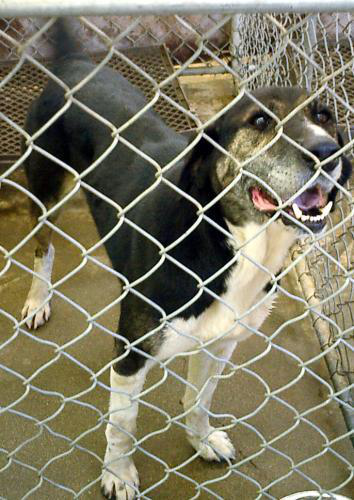

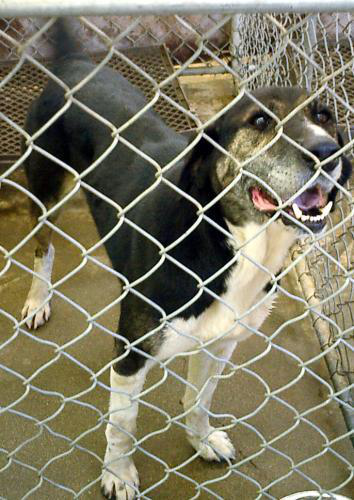

Race donnée : Walker_hound
Race sans rognage : Labrador_retriever
Race prédite avec rognage si détection : Labrador_retriever
#############################################################

Cas n°9


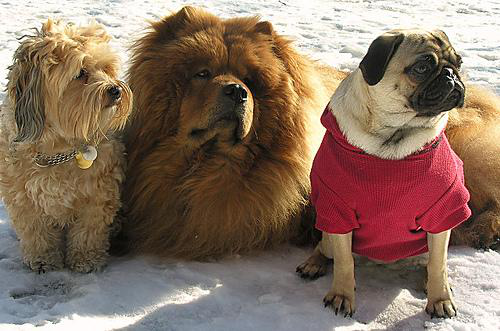

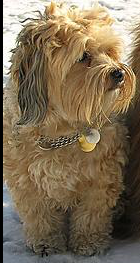

Race donnée : chow
Race sans rognage : chow
Race prédite avec rognage si détection : Tibetan_terrier
#############################################################

Cas n°10


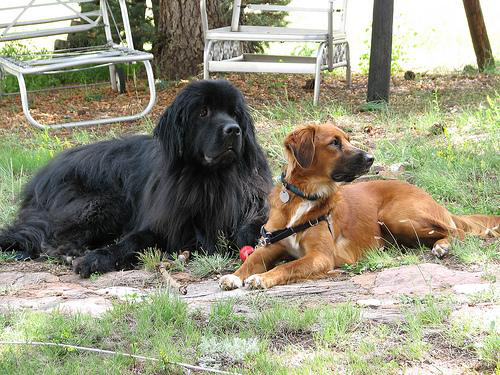

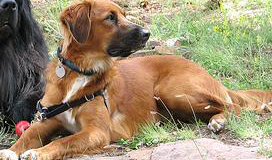

Race donnée : Newfoundland
Race sans rognage : Newfoundland
Race prédite avec rognage si détection : Leonberg
#############################################################

Cas n°11


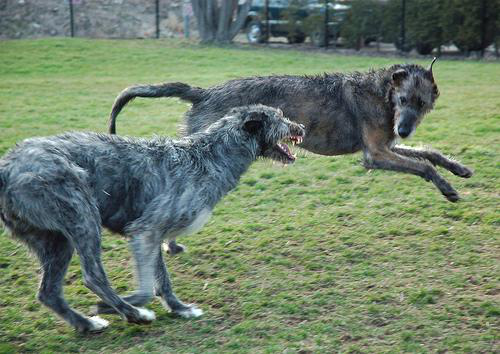

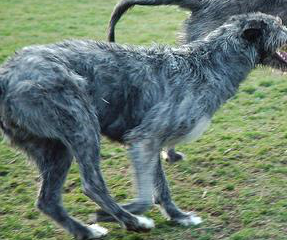

Race donnée : Irish_wolfhound
Race sans rognage : Scottish_deerhound
Race prédite avec rognage si détection : Scottish_deerhound
#############################################################

Cas n°12


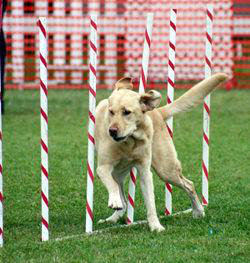

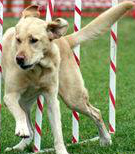

Race donnée : Labrador_retriever
Race sans rognage : Labrador_retriever
Race prédite avec rognage si détection : Chesapeake_Bay_retriever
#############################################################

Cas n°13


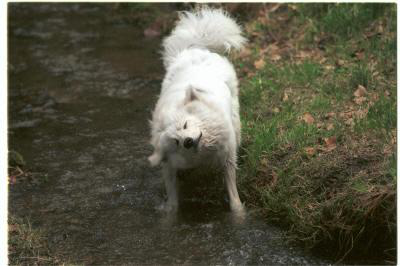

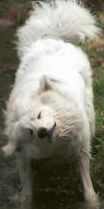

Race donnée : Samoyed
Race sans rognage : Samoyed
Race prédite avec rognage si détection : Great_Pyrenees
#############################################################

Cas n°14


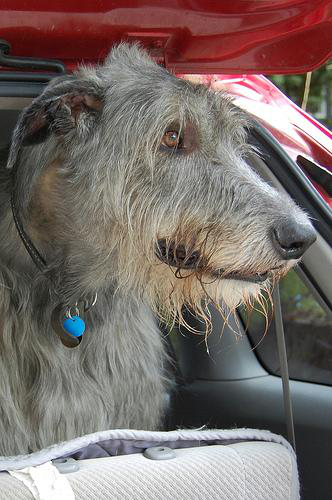

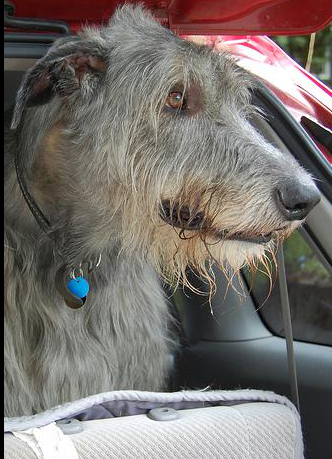

Race donnée : Irish_wolfhound
Race sans rognage : Scottish_deerhound
Race prédite avec rognage si détection : Scottish_deerhound
#############################################################

Cas n°15


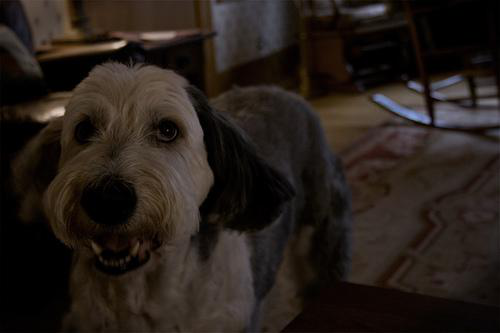

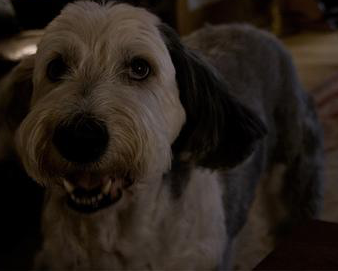

Race donnée : Old_English_sheepdog
Race sans rognage : otterhound
Race prédite avec rognage si détection : otterhound
#############################################################

Cas n°16


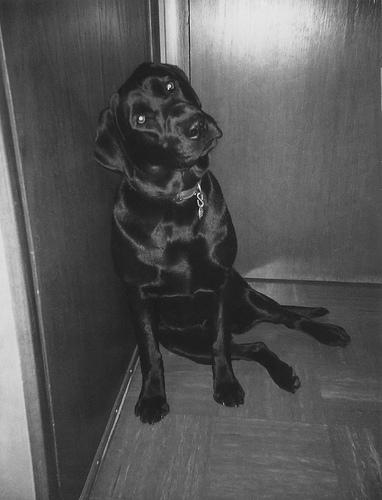

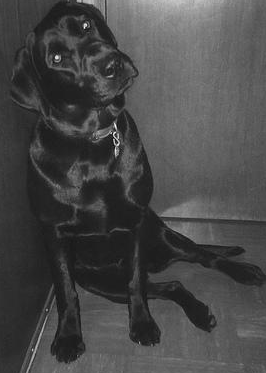

Race donnée : Labrador_retriever
Race sans rognage : Labrador_retriever
Race prédite avec rognage si détection : Great_Dane
#############################################################

Cas n°17


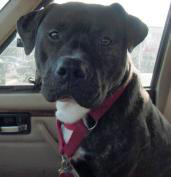

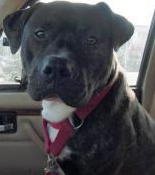

Race donnée : American_Staffordshire_terrier
Race sans rognage : Staffordshire_bullterrier
Race prédite avec rognage si détection : Staffordshire_bullterrier
#############################################################

Cas n°18


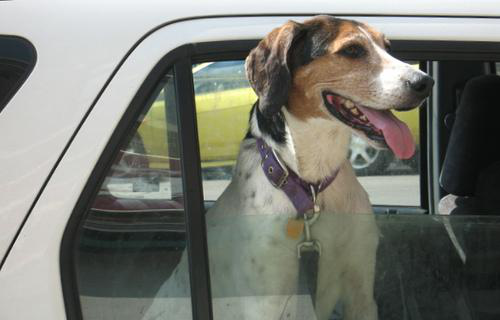

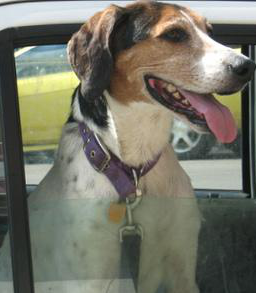

Race donnée : Walker_hound
Race sans rognage : EntleBucher
Race prédite avec rognage si détection : EntleBucher
#############################################################

Cas n°19


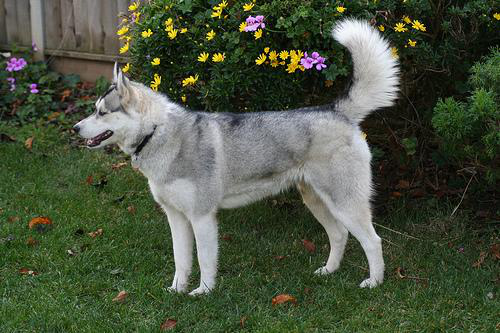

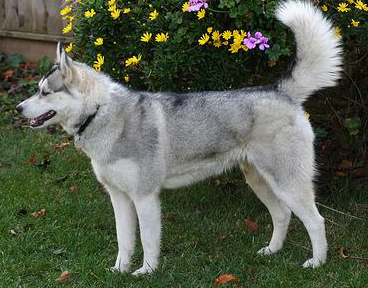

Race donnée : Eskimo_dog
Race sans rognage : Siberian_husky
Race prédite avec rognage si détection : Siberian_husky
#############################################################



In [34]:
for i in range(20):
  print(f"Cas n°{i}")
  img = test_error_predict_crop.uri[i]
  img = load_img(img)
  display(img)
  width, height = img.size

  # Rognage si chien détecté
  if ~np.isnan(test_error_predict_crop.center_x[i]):
    # Transformation des coordonnées relatives en coordonnées interprétables
    center_x = width * test_error_predict_crop['center_x'][i]
    center_y = height * test_error_predict_crop['center_y'][i]
    h_crop = height * test_error_predict_crop['height'][i]
    w_crop = width * test_error_predict_crop['width'][i]

    left = center_x - w_crop / 2
    top = center_y - h_crop / 2
    right = center_x + w_crop / 2
    bottom = center_y + h_crop / 2

    # Rognage sur objet à identifier et transformation avant prédicition
    img = img.crop((left, top, right, bottom))

  display(img)
  # Classification de la photo avec ou sans rognage
  img = img.resize((299, 299))
  input_array = np.reshape(img_to_array(img), (-1, 299, 299, 3)) / 255

  # Prédiction de la race
  output = model.predict(input_array)
  breeds = class_label.at[output.argmax(axis=-1)[0], 'index']
  
  
  print(f'Race donnée : {test_error_predict_crop.breeds[i]}')
  print(f'Race sans rognage : {test_error_predict_crop.predicted_breeds[i]}')
  print(f'Race prédite avec rognage si détection : {breeds}')
  print("#############################################################")
  print("")
  

### 3-4-3. Objets détecté dans le cas n°4

In [35]:
test_error_predict_crop.uri[4]

'/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P6_Classez_des_images_à_l_aide_d_algorithmes_de_deep_learning/dev/src/img/n02090721-Irish_wolfhound/n02090721_1954.jpg'

In [36]:
%%capture 
!./darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights -ext_output "/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P6_Classez_des_images_à_l_aide_d_algorithmes_de_deep_learning/dev/src/img/n02090721-Irish_wolfhound/n02090721_1954.jpg"

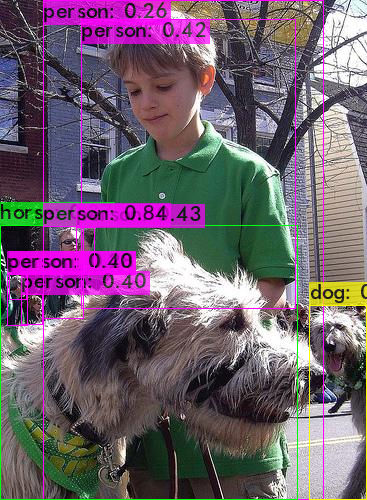

In [37]:
load_img('predictions.jpg')

Dans ce cas, le chien principal est identifié comme un cheval, il est naturellement exclu de la zone d'analyse par l'algorithme. La machine identifie donc le chien en fond d'image.

### 3-4-4. Objets détecté dans le cas n°8

In [38]:
test_error_predict_crop.uri[8]

'/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P6_Classez_des_images_à_l_aide_d_algorithmes_de_deep_learning/dev/src/img/n02089867-Walker_hound/n02089867_2387.jpg'

In [39]:
%%capture 
!./darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights -ext_output "/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P6_Classez_des_images_à_l_aide_d_algorithmes_de_deep_learning/dev/src/img/n02089867-Walker_hound/n02089867_2387.jpg"

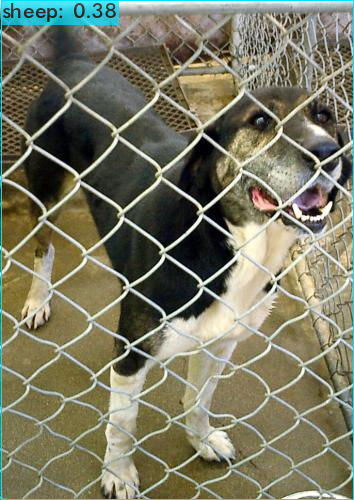

In [40]:
load_img('predictions.jpg')

Certainement du fait du grillage, l'animal est identifié comme un mouton. L'image est envoyé d'origine au classifieur. Dans ce cas précis et dans un autre étape, nous pourrions être tenter de reconstruire l'image.

### 3-4-5. Objets détecté dans le cas n°9

In [41]:
test_error_predict_crop.uri[9]

'/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P6_Classez_des_images_à_l_aide_d_algorithmes_de_deep_learning/dev/src/img/n02112137-chow/n02112137_12741.jpg'

In [42]:
%%capture 
!./darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights -ext_output "/content/drive/My Drive/Formation/Informatique - Digital/OpenClassroom/IML/P6_Classez_des_images_à_l_aide_d_algorithmes_de_deep_learning/dev/src/img/n02112137-chow/n02112137_12741.jpg"

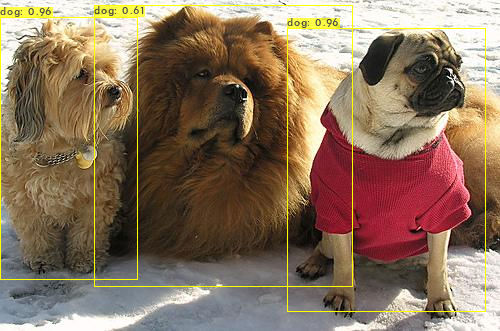

In [43]:
load_img('predictions.jpg')

Ici, le chien prenant le plus de place sur la photos et reconnu comme race par les données, n'est pas reconnue comme chien principal envoyé à l'algorithme.

## 3-5. Rapport global de classification

In [44]:
class_report = classification_report(test_file.breeds, test_file.predicted_breeds_crop, output_dict=True)
class_report_df = pd.DataFrame.from_dict(class_report, orient='columns').transpose().head(-3)
pd.set_option('display.max_rows', None)
class_report_df.sort_values('precision')

,precision,recall,f1-score,support
miniature_poodle,0.529412,0.720000,0.610169,25.0
English_foxhound,0.542373,0.941176,0.688172,34.0
Tibetan_mastiff,0.562500,0.900000,0.692308,30.0
Siberian_husky,0.589041,0.877551,0.704918,49.0
Eskimo_dog,0.636364,0.269231,0.378378,26.0
toy_terrier,0.647059,0.942857,0.767442,35.0
Border_collie,0.648649,0.923077,0.761905,26.0
Cardigan,0.680851,0.888889,0.771084,36.0
Tibetan_terrier,0.704918,0.955556,0.811321,45.0
Yorkshire_terrier,0.717949,0.777778,0.746667,36.0


---
# 4. Création des photos rognées pour apprentissage
Bloc 4 exécuté 1 fois seulement

In [ ]:
dogs = pd.read_csv(path_img + 'src/dogs.csv')
dogs.uri = dogs.uri.apply(lambda x : path_img + x).str.replace('\\', '/')
dogs['breeds'] = dogs.uri.str.split('/').str.get(12).str.slice(10)
dogs['filename'] = dogs['uri'].str.split('/').str.get(13)
dogs

,uri,breeds,filename
0,/content/drive/My Drive/Formation/Informatique...,Chihuahua,n02085620_10074.jpg
1,/content/drive/My Drive/Formation/Informatique...,Chihuahua,n02085620_10131.jpg
2,/content/drive/My Drive/Formation/Informatique...,Chihuahua,n02085620_10621.jpg
3,/content/drive/My Drive/Formation/Informatique...,Chihuahua,n02085620_1073.jpg
4,/content/drive/My Drive/Formation/Informatique...,Chihuahua,n02085620_10976.jpg
...,...,...,...
20574,/content/drive/My Drive/Formation/Informatique...,African_hunting_dog,n02116738_9798.jpg
20575,/content/drive/My Drive/Formation/Informatique...,African_hunting_dog,n02116738_9818.jpg
20576,/content/drive/My Drive/Formation/Informatique...,African_hunting_dog,n02116738_9829.jpg
20577,/content/drive/My Drive/Formation/Informatique...,African_hunting_dog,n02116738_9844.jpg


In [ ]:
%%capture
# Extraction des uri dans un fichier texte
dogs.uri.to_csv('/content/images_dogs.txt', index=False, header=False)
# Détection des objets identifiés dans les images à partir du fichier texte
# Stockage des résultats dans un JSON
!./darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights -dont_show -ext_output -out /content/result.json < /content/images_dogs.txt

In [ ]:
# Transformation du JSON en dataframe
result_crop = pd.read_json('/content/result.json')
# Récupération de l'objet identifié comme un chien avec la meilleur confidence
result_crop = get_best_object(result_crop)
# Assemblage des données dans un dataframe
dogs = pd.merge(dogs, result_crop, left_index=True, right_index=True)
col = ['uri', 'breeds', 'filename', 'center_x', 'center_y', 'width', 'height']
dogs = dogs[col]
dogs.head()

,uri,breeds,filename,center_x,center_y,width,height
0,/content/drive/My Drive/Formation/Informatique...,Chihuahua,n02085620_10074.jpg,0.455568,0.489279,0.804954,1.057105
1,/content/drive/My Drive/Formation/Informatique...,Chihuahua,n02085620_10131.jpg,0.548339,0.504275,0.855886,0.966300
2,/content/drive/My Drive/Formation/Informatique...,Chihuahua,n02085620_10621.jpg,0.482755,0.502806,0.389775,0.703651
3,/content/drive/My Drive/Formation/Informatique...,Chihuahua,n02085620_1073.jpg,0.488581,0.530515,0.992405,0.990712
4,/content/drive/My Drive/Formation/Informatique...,Chihuahua,n02085620_10976.jpg,0.517973,0.559173,0.490166,0.733000


In [ ]:
for i in range(len(dogs)):
  # print(f'Traitement de la photo {i} en cours ...')
  img = dogs.uri[i]
  img = load_img(img)

  width, height = img.size

  # Rognage si chien détecté
  if ~np.isnan(dogs.center_x[i]):
    # Transformation des coordonnées relatives en coordonnées interprétables
    center_x = width * dogs['center_x'][i]
    center_y = height * dogs['center_y'][i]
    h_crop = height * dogs['height'][i]
    w_crop = width * dogs['width'][i]

    left = center_x - w_crop / 2
    top = center_y - h_crop / 2
    right = center_x + w_crop / 2
    bottom = center_y + h_crop / 2

    # Rognage sur objet à identifier et transformation avant prédicition
    img = img.crop((left, top, right, bottom))

  # Enregistrement de la photos
  path_crop = path + 'img_crop/' + dogs.breeds[i] + '/'

  img.save(path_crop + dogs.filename[i])